# Install dependencies and detectron2

In [1]:
# install dependencies
!pip install -U torch torchvision cython Pillow==6.2.2
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__
!gcc --version
# opencv is pre-installed on colab

Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.4.0)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.5.0)
Requirement already up-to-date: cython in /usr/local/lib/python3.6/dist-packages (0.29.14)
Requirement already up-to-date: Pillow==6.2.2 in /usr/local/lib/python3.6/dist-packages (6.2.2)
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-7h17b8e9
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-7h17b8e9
  Created wheel for pycocotools: filename=pycocotools-2.0-cp36-cp36m-linux_x86_64.whl size=275254 sha256=66a6b66ffb350044c33868d8c06aa11ed56b92185781a00dcfd3dc1cbdde1b41
  Stored in directory: /tmp/pip-ephem-wheel-cache-rbtlmdxj/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
  Found existing installation: pycocotools 2.0.0
    Uninstalling pycocotools-2.0.0:
      Successfully uninstalled py

In [2]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 55, done.
remote: Counting objects: 100% (55/55), done.
remote: Compressing objects: 100% (47/47), done.
remote: Total 2791 (delta 10), reused 25 (delta 7), pack-reused 2736
Receiving objects: 100% (2791/2791), 1.95 MiB | 4.04 MiB/s, done.
Resolving deltas: 100% (1870/1870), done.
Obtaining file:///content/detectron2_repo
     |████████████████████████████████| 61kB 3.7MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.dev200209-cp36-none-any.whl size=34351 sha256=25778efa193a72ea9950c9dbef7c72382242279b9af0b8629c1fc06ccc321b59
  Stored in directory: /root/.cache/pip/wheels/65/6c/88/397a782ebb8a96cc975e98217f1349bed0c9f36a8d8d7ea524
Successfully built fvcore
ERROR: fvcore 0.1.dev200209 has requirement pyyaml>=5.1, but you'll have pyyaml 3.13 which is incompatible.
  Found existing installation: tqdm 4.28.1
    Uninstalling tqdm-4.28.1:
      Successfully uninstalled tqdm-4.28.1
  Running setup.py develop for detectron2


# Import libraries

In [0]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Download or import example images

In [0]:
# #you can either download images or import them from mount

!wget https://www.athensguide.com/shopping/ermou-street.jpg -O input.jpg
!wget https://hips.hearstapps.com/ghk.h-cdn.co/assets/cm/15/11/54ff82234196d-jws-11-xln.jpg -O input2.jpg
!wget https://upload.wikimedia.org/wikipedia/commons/thumb/b/b1/20160516_350_thessaloniki.jpg/1200px-20160516_350_thessaloniki.jpg -O input3.jpg
!wget https://www.newsbeast.gr/files/1/2016/02/ortty04.jpg -O input4.jpg
!wget https://static.advrider.com/wp-content/uploads/2019/05/6629.jpg -O input5.jpg
!wget https://www.tovima.gr/wp-content/uploads/2019/02/01/13425058_h3350765.jpg -O input6.jpg
!wget http://athina984.gr/wp-site/wp-content/uploads/2018/11/%CE%B5%CF%81%CE%BC%CE%BF%CF%8D-650x400.jpg -O input7.jpg
!wget https://www.thepressroom.gr/sites/default/files/styles/article/public/field/articles/images/ermou.jpg?itok=gFbsu0pn -O input8.jpg
!wget https://restaurant.opentable.com/news/wp-content/uploads/sites/100/2015/06/pizzaiolo_6542.jpg -O input9.jpg
!wget https://www.roadaffair.com/wp-content/uploads/2019/03/tourists-boat-giethoorn-netherlands-shutterstock_1250302012-1024x683.jpg -O input10.jpg

--2020-02-08 19:42:44--  https://www.athensguide.com/shopping/ermou-street.jpg
Resolving www.athensguide.com (www.athensguide.com)... 158.106.190.55
Connecting to www.athensguide.com (www.athensguide.com)|158.106.190.55|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 94750 (93K) [image/jpeg]
Saving to: ‘input.jpg’

input.jpg           100%[===================>]  92.53K   216KB/s    in 0.4s    

2020-02-08 19:42:45 (216 KB/s) - ‘input.jpg’ saved [94750/94750]

--2020-02-08 19:42:49--  https://hips.hearstapps.com/ghk.h-cdn.co/assets/cm/15/11/54ff82234196d-jws-11-xln.jpg
Resolving hips.hearstapps.com (hips.hearstapps.com)... 151.101.0.155, 151.101.64.155, 151.101.128.155, ...
Connecting to hips.hearstapps.com (hips.hearstapps.com)|151.101.0.155|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 76916 (75K) [image/jpeg]
Saving to: ‘input2.jpg’

input2.jpg          100%[===================>]  75.11K  --.-KB/s    in 0.002s  

2020-02-08 19:42:

In [2]:
#Import them from drive
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
#copy images folder with its files to my dir
!cp -rf /content/gdrive/My\ Drive/detectron2_inputs/* /content/

# Read and show images

In [0]:
im = cv2.imread("./input.jpg")
im2 = cv2.imread("./input2.jpg")
im3 = cv2.imread("./input3.jpg")
im4 = cv2.imread("./input4.jpg")
im5 = cv2.imread("./input5.jpg")
im6 = cv2.imread("./input6.jpg")
im7 = cv2.imread("./input7.jpg")
im8 = cv2.imread("./input8.jpg")
im9 = cv2.imread("./input9.jpg")
im10 = cv2.imread("./input10.jpg")

Image 1: 



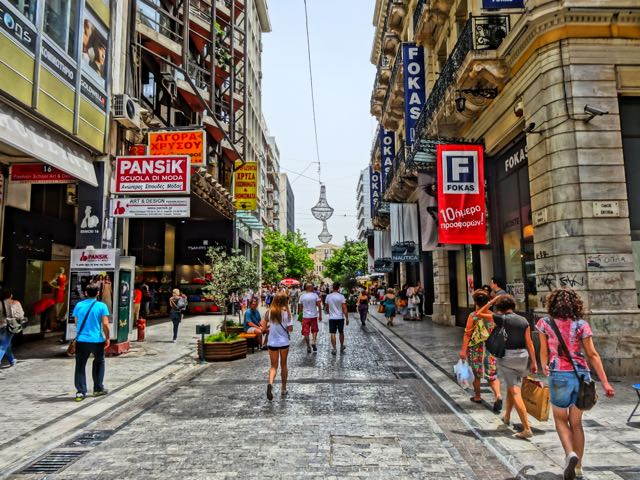

Image 2: 



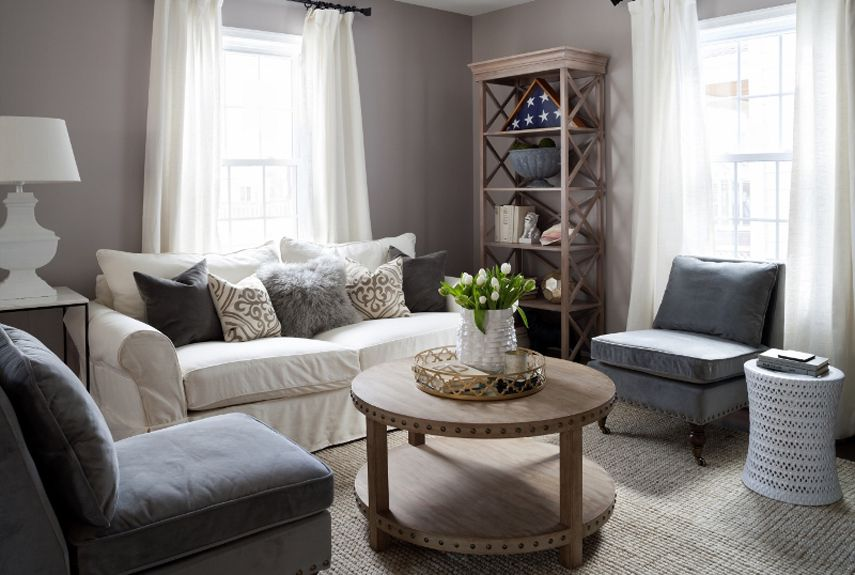

Image 3: 



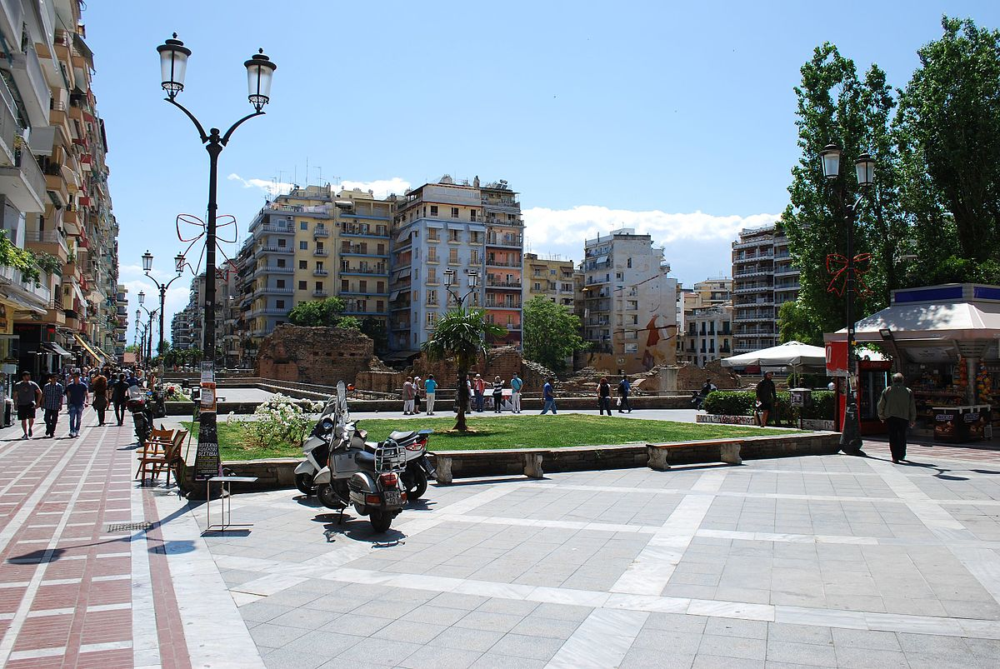

Image 4: 



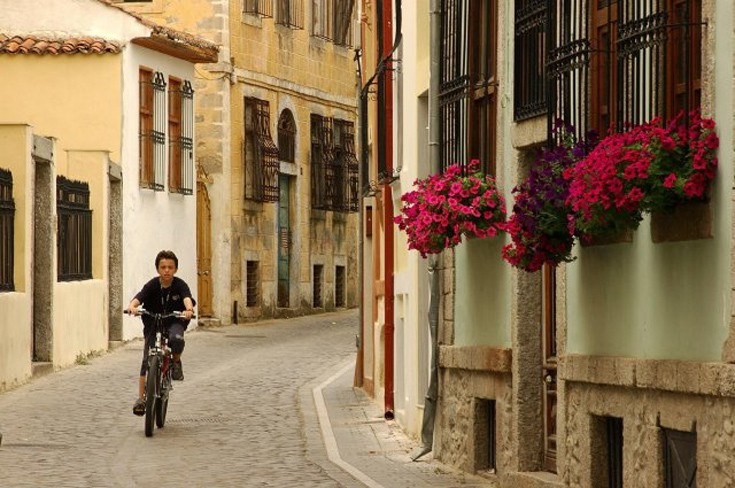

Image 5: 



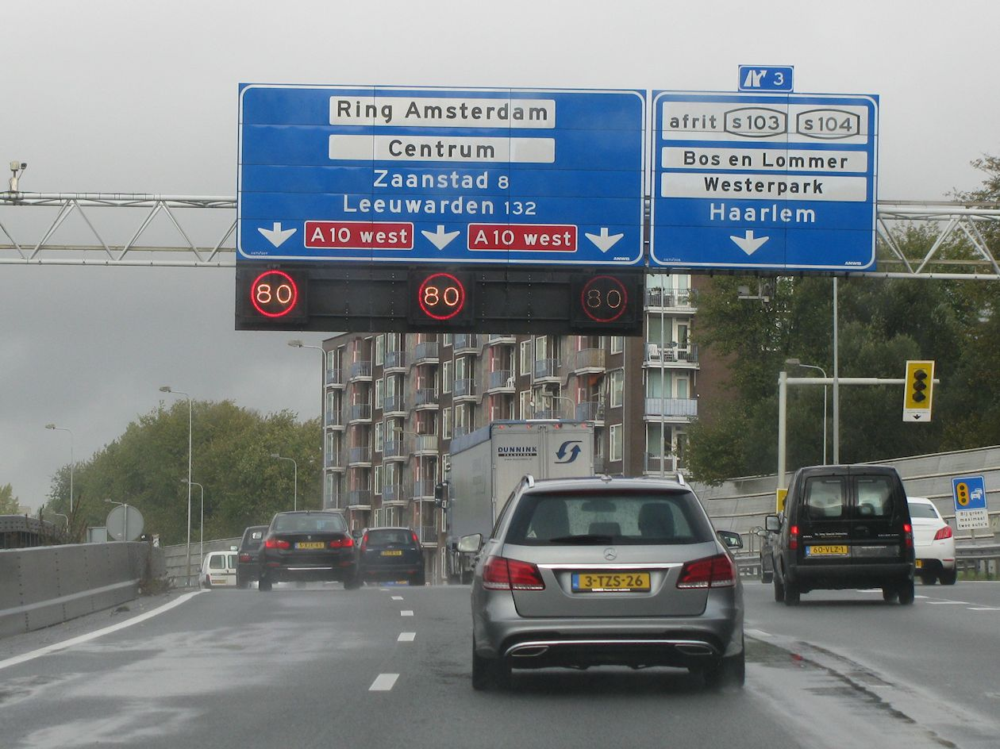

Image 6: 



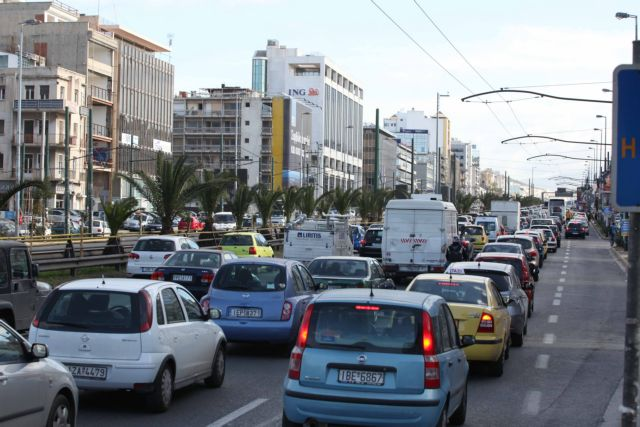

Image 7: 



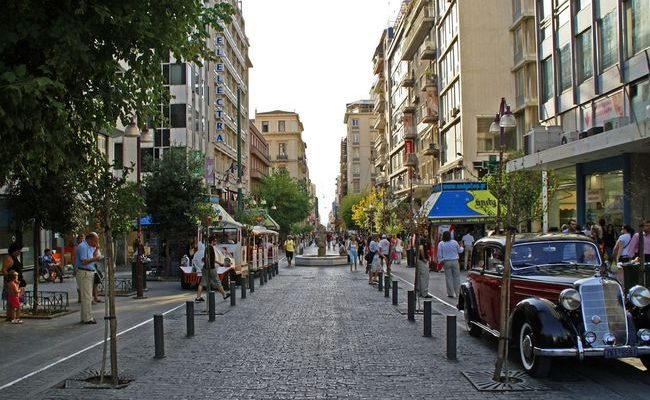

Image 8: 



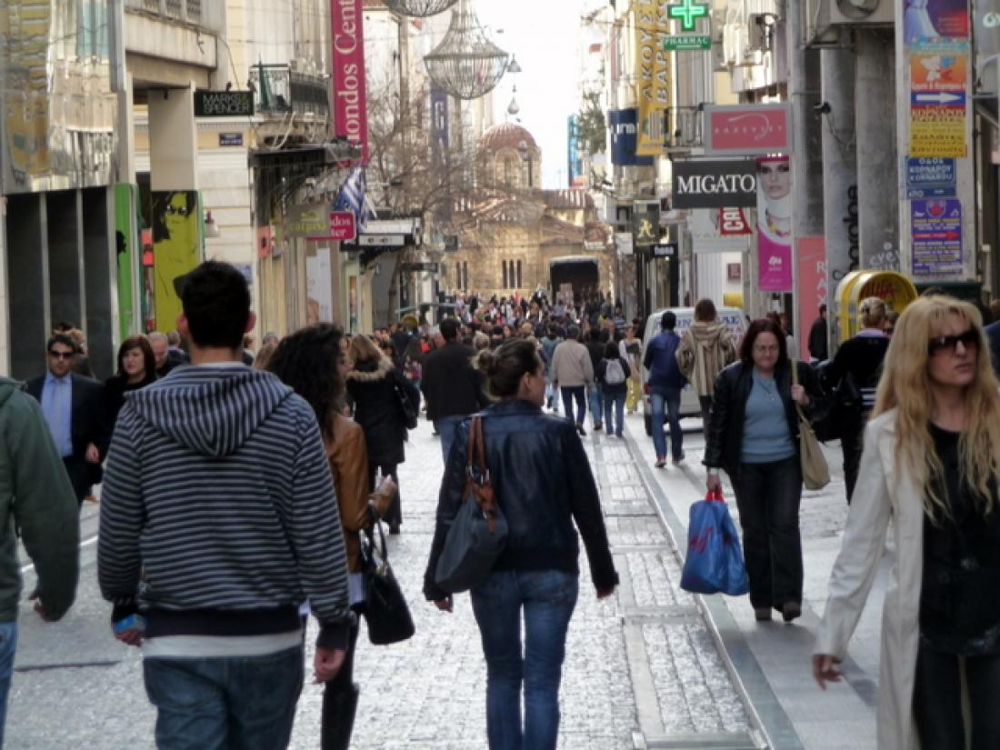

Image 9: 



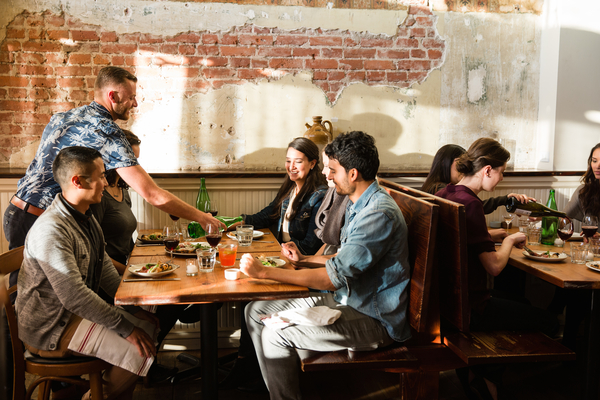

Image 10: 



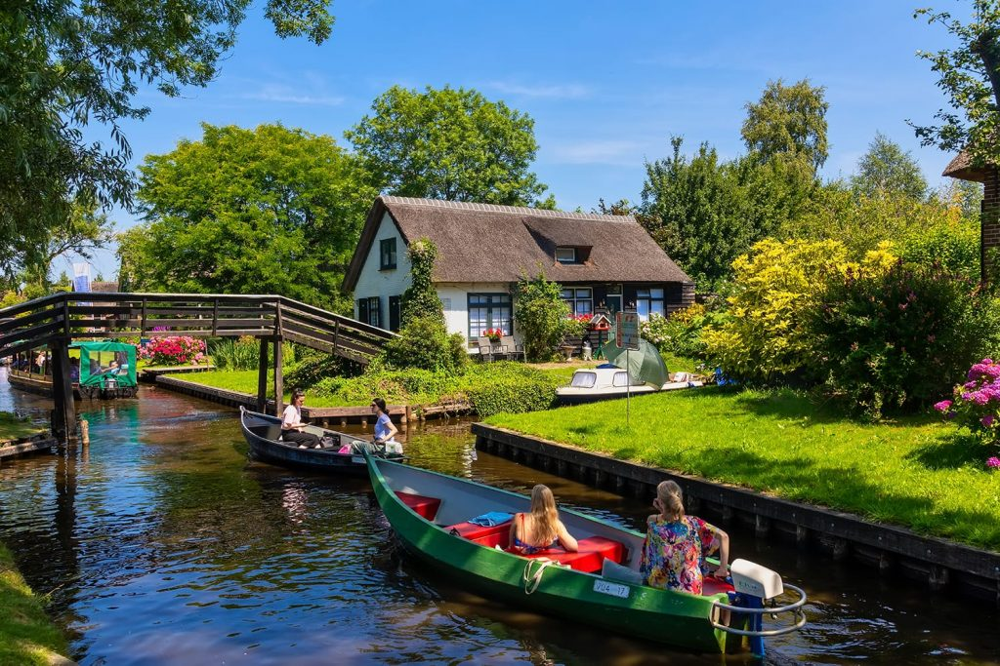

In [5]:
print("Image 1: \n")
cv2_imshow(im)
print("Image 2: \n")
cv2_imshow(im2)
print("Image 3: \n")
cv2_imshow(im3)
print("Image 4: \n")
cv2_imshow(im4)
print("Image 5: \n")
cv2_imshow(im5)
print("Image 6: \n")
cv2_imshow(im6)
print("Image 7: \n")
cv2_imshow(im7)
print("Image 8: \n")
cv2_imshow(im8)
print("Image 9: \n")
cv2_imshow(im9)
print("Image 10: \n")
cv2_imshow(im10)

# Run inference with a keypoint detection model

In [6]:
# Inference with a keypoint detection model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # set threshold for this model
cfg.MODEL.WEIGHTS = "detectron2://COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x/137849621/model_final_a6e10b.pkl"
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
outputs2 = predictor(im2)
outputs3 = predictor(im3)
outputs4 = predictor(im4)
outputs5 = predictor(im5)
outputs6 = predictor(im6)
outputs7 = predictor(im7)
outputs8 = predictor(im8)
outputs9 = predictor(im9)
outputs10 = predictor(im10)

model_final_a6e10b.pkl: 237MB [00:21, 11.2MB/s]                           


# Visualize keypoint detection model results

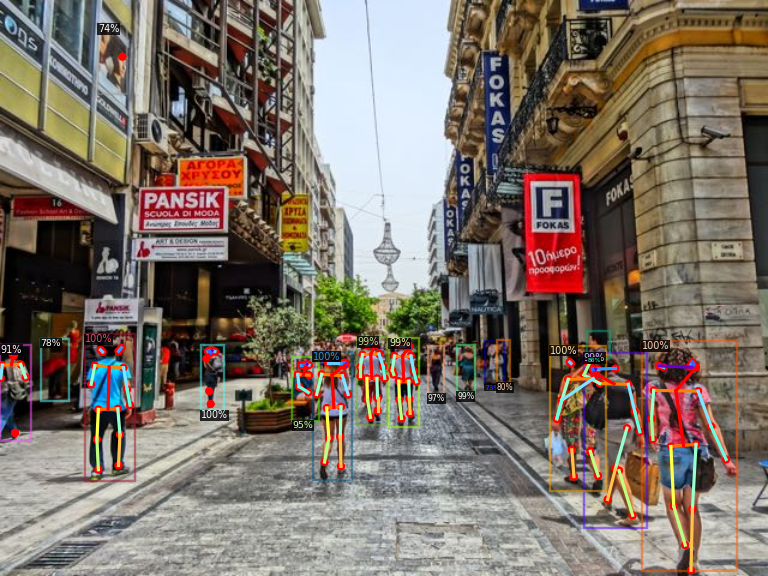

In [7]:
v = Visualizer(im[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

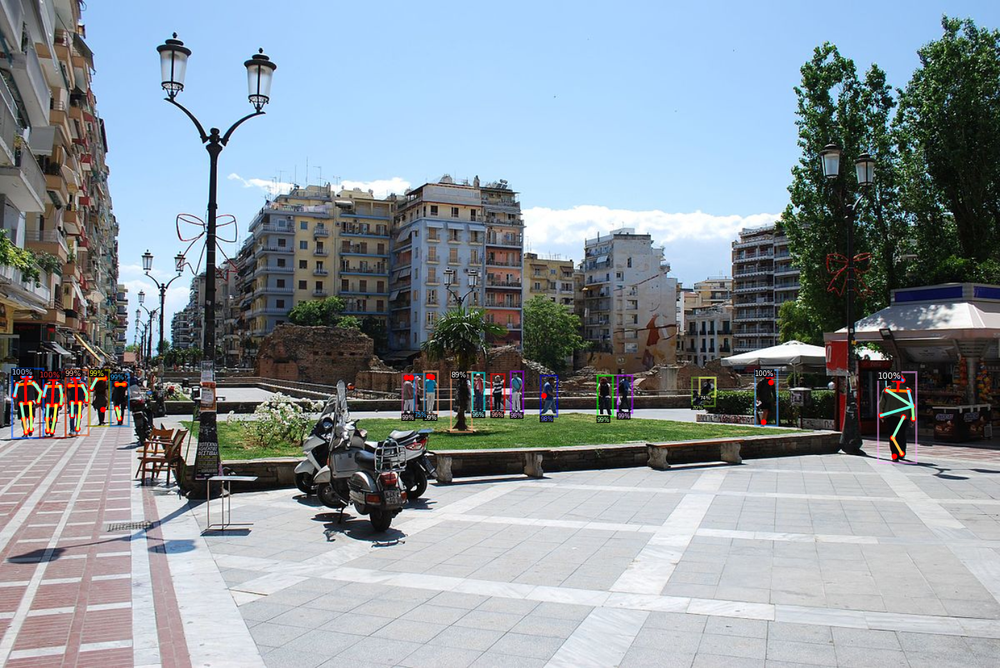

In [8]:
v = Visualizer(im3[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs3["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

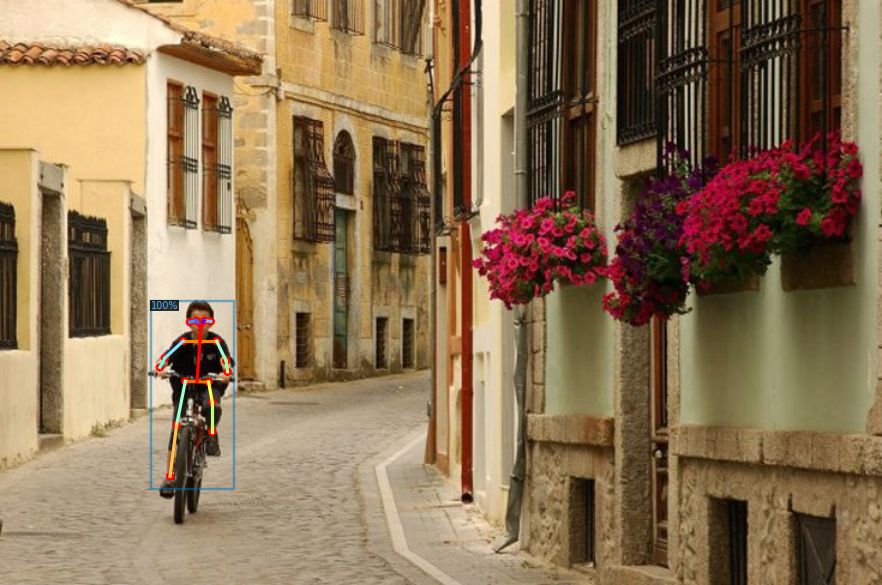

In [9]:
v = Visualizer(im4[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs4["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

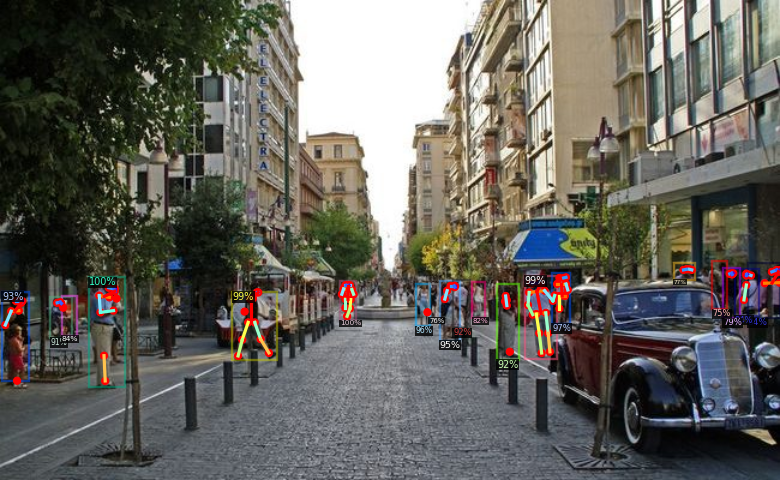

In [10]:
v = Visualizer(im7[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs7["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

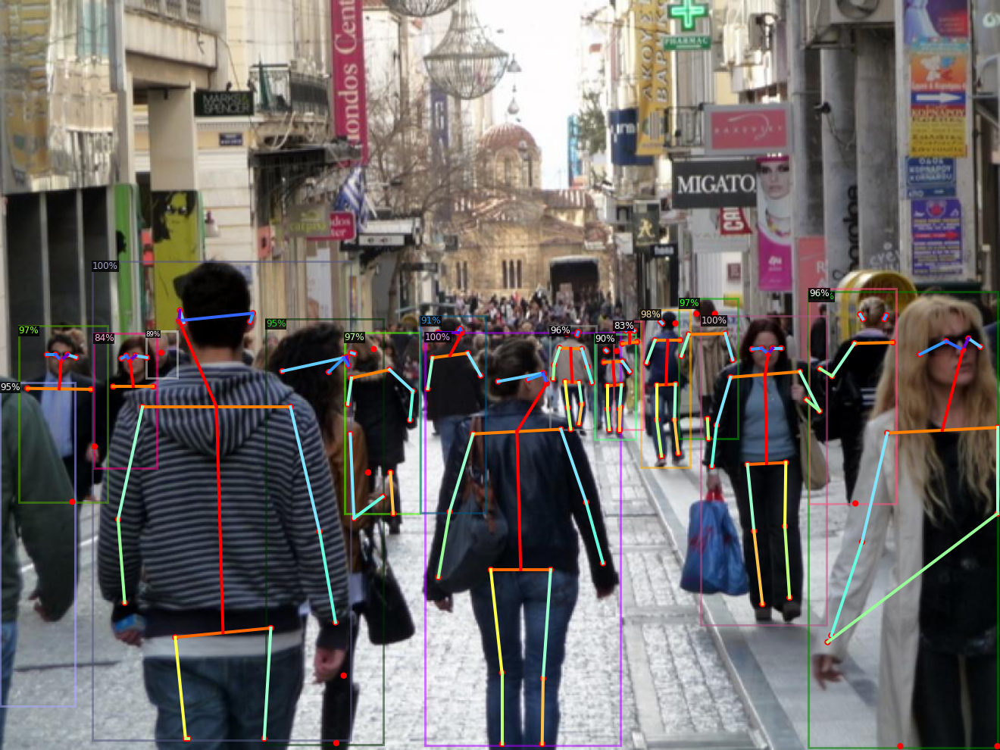

In [11]:
v = Visualizer(im8[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs8["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

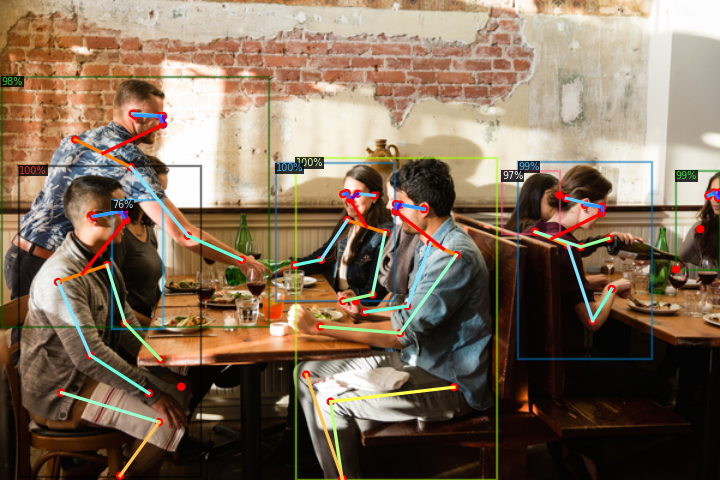

In [12]:
v = Visualizer(im9[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs9["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

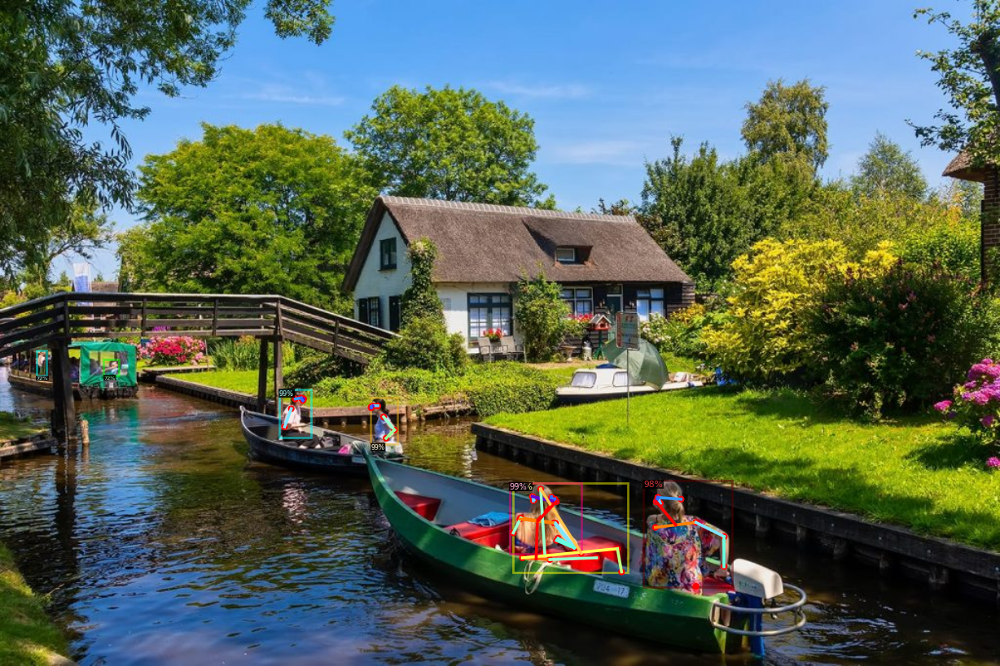

In [13]:
v = Visualizer(im10[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs10["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])